$\Large\color{blue}{\text{PyGMTSAR Small Baseline Subset (SBAS) Interferometric InSAR}}$

$\Large\color{blue}{\text{On GMTSAR dataset S1A_Stack_CPGF_T173}}$

$\large\color{blue}{\text{Ehnanced SBAS processing excludes atmosperic noise and validates results}}$

### Look for more PyGMTSAR examples:

* Google Colab - see GitHub page for [notebooks](https://github.com/mobigroup/gmtsar),

* Docker Images on [DockerHub](https://hub.docker.com/r/mobigroup/pygmtsar),

* GitHub [notebooks](https://github.com/mobigroup/gmtsar/tree/master/notebooks),

* GitHub Actions [console scripts](https://github.com/mobigroup/gmtsar/actions),

* Google Cloud VM -  follow [PyGMTSAR documentation](https://mobigroup.github.io/gmtsar/),

* Linux Debian and Ubuntu -  follow [PyGMTSAR documentation](https://mobigroup.github.io/gmtsar/),

* Apple Silicon and Intel hosts -  follow [PyGMTSAR documentation](https://mobigroup.github.io/gmtsar/).


### PyGMTSAR InSAR library, Geomed3D Geophysical Inversion Library, N-Cube 3D/4D GIS Data Visualization, etc. are my free-time Open Source projects.

I have STEM master’s degree in radio physics and in 2004 I have got the first prize of the All-Russian Physics competition for significant results in forward and inverse modeling for non-linear optics and holography, also applicable for modeling of Gravity, Magnetic, and Thermal fields and satellite interferometry processing. And I’m data scientist and software developer with 20 year’s experience in science and industrial development. I had been working on government contracts and universities projects and on projects for LG Corp, Google Inc, etc.

### You can sponsor my work on [Patreon](https://www.patreon.com/pechnikov) where I share my projects updates, publications, use cases, examples, and other useful information. To order some research and development and support, see my profile on freelance platform [Upwork](https://www.upwork.com/freelancers/~01e65e8e7221758623). 

### Resources

* [Patreon](https://www.patreon.com/pechnikov),

* [YouTube Geological Models](https://www.youtube.com/channel/UCSEeXKAn9f_bDiTjT6l87Lg),

* [Virtual and Augmented Reality (VR/AR) Geological Models](https://mobigroup.github.io/ParaView-Blender-AR/),

* [GitHub](https://github.com/mobigroup),

* [LinkedIn](https://www.linkedin.com/in/alexey-pechnikov/),

* [Medium](https://medium.com/@pechnikov),

* [Habr](https://habr.com/ru/users/N-Cube/posts/).

### @ Alexey Pechnikov, 2023

$\large\color{blue}{\text{Hint: Use menu Cell} \to \text{Run All or Runtime} \to \text{Complete All or Runtime} \to \text{Run All}}$
$\large\color{blue}{\text{(depending of your localization settings) to execute the entire notebook}}$

## Load Modules to Check Environment

In [1]:
import platform, sys, os

## Google Colab Installation

### Install GMTSAR
https://github.com/gmtsar/gmtsar

In [2]:
if 'google.colab' in sys.modules:
    count = !ls /usr/local | grep GMTSAR | wc -l
    if count == ['0']:
        !apt install -y csh autoconf gfortran \
            libtiff5-dev libhdf5-dev liblapack-dev libgmt-dev gmt-dcw gmt-gshhg gmt > /dev/null
        !cd /usr/local && git clone --branch master https://github.com/gmtsar/gmtsar GMTSAR > /dev/null
        !cd /usr/local/GMTSAR && autoconf > /dev/null
        !cd /usr/local/GMTSAR && ./configure --with-orbits-dir=/tmp > /dev/null
        !cd /usr/local/GMTSAR && make 1>/dev/null 2>/dev/null
        !cd /usr/local/GMTSAR && make install >/dev/null



Cloning into 'GMTSAR'...
remote: Enumerating objects: 5998, done.
remote: Counting objects: 100% (151/151), done.
remote: Compressing objects: 100% (86/86), done.
remote: Total 5998 (delta 72), reused 133 (delta 64), pack-reused 5847
Receiving objects: 100% (5998/5998), 18.15 MiB | 18.44 MiB/s, done.
Resolving deltas: 100% (4081/4081), done.


### Define ENV Variables for Jupyter Instance

In [3]:
# use default GMTSAR installation path
PATH = os.environ['PATH']
if PATH.find('GMTSAR') == -1:
    PATH = os.environ['PATH'] + ':/usr/local/GMTSAR/bin/'
    %env PATH {PATH}

env: PATH=/opt/bin:/usr/local/nvidia/bin:/usr/local/cuda/bin:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/tools/node/bin:/tools/google-cloud-sdk/bin:/usr/local/GMTSAR/bin/


### Install Python Modules

Maybe you need to restart your notebook, follow the instructions printing below.

The installation takes a long time on fresh Debian 10 and a short time on Google Colab

In [4]:
!{sys.executable} --version

Python 3.9.16


In [5]:
if 'google.colab' in sys.modules:
    !{sys.executable} -m pip install matplotlib seaborn geoviews hvplot datashader bokeh >/dev/null

In [6]:
!{sys.executable} -m pip install pygmtsar >/dev/null

## Load and Setup Python Modules

In [7]:
import xarray as xr
import numpy as np
import pandas as pd
# supress numpy warnings
import warnings
warnings.filterwarnings('ignore')
from dask.distributed import Client

In [8]:
# plotting modules
from IPython.display import Image
import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline

In [9]:
# show interactive plots if allowed
# attention: the plots require a lot of RAM and produce segfaults on some environments
USE_INTERACTIVE_PLOTS = False
if USE_INTERACTIVE_PLOTS:
    import hvplot.pandas  # noqa
    import hvplot.xarray  # noqa
    import holoviews as hv
    pd.options.plotting.backend = 'hvplot'
    gstiles = hv.Tiles('https://mt1.google.com/vt/lyrs=s&x={X}&y={Y}&z={Z}', name='Google Satellite')
    ottiles = hv.Tiles('https://tile.opentopomap.org/{Z}/{X}/{Y}.png', name='Open Topo')

In [10]:
from pygmtsar import SBAS

## Download and unpack example dataset

In [11]:
#wget -c http://topex.ucsd.edu/gmtsar/tar/S1A_Stack_CPGF_T173.tar.gz
if 'google.colab' in sys.modules:
    !apt install -y subversion jq
!svn export --force https://github.com/mobigroup/gmtsar/trunk/tests/icloud_download.sh && chmod a+x icloud_download.sh
!./icloud_download.sh "https://www.icloud.com/iclouddrive/0b2SKaQ9FokMxD75yu6FF5lyg#S1A_Stack_CPGF_T173.tar.gz"
!rm -rf raw_orig topo && tar xvzf S1A_Stack_CPGF_T173.tar.gz -C . && rm -f raw_orig/._*

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  libapr1 libaprutil1 libjq1 libonig5 libserf-1-1 libsvn1 libutf8proc2
Suggested packages:
  db5.3-util libapache2-mod-svn subversion-tools
The following NEW packages will be installed:
  jq libapr1 libaprutil1 libjq1 libonig5 libserf-1-1 libsvn1 libutf8proc2
  subversion
0 upgraded, 9 newly installed, 0 to remove and 24 not upgraded.
Need to get 2,668 kB of archives.
After this operation, 11.4 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu focal/universe amd64 libonig5 amd64 6.9.4-1 [142 kB]
Get:2 http://archive.ubuntu.com/ubuntu focal-updates/universe amd64 libjq1 amd64 1.6-1ubuntu0.20.04.1 [121 kB]
Get:3 http://archive.ubuntu.com/ubuntu focal-updates/universe amd64 jq amd64 1.6-1ubuntu0.20.04.1 [50.2 kB]
Get:4 http://archive.ubuntu.com/ubuntu focal/main amd64 libapr1 amd64 1.6.5-1ubuntu1 [91.4 kB]
Get:5

## Define Parameters

In [12]:
MASTER       = '2015-04-03'
WORKDIR      = 'raw_stack'
DATADIR      = 'raw_orig'
DEMFILE      = 'topo/dem.grd'
BASEDAYS     = 100
BASEMETERS   = 150
DEFOMAX      = 0

## Run Local Dask Cluster

Launch Dask cluster for local and distributed multicore computing. That's possible to process terabyte scale Sentinel-1 SLC datasets on Apple Air 16 GB RAM.

In [13]:
client = Client()
client

INFO:distributed.http.proxy:To route to workers diagnostics web server please install jupyter-server-proxy: python -m pip install jupyter-server-proxy
INFO:distributed.scheduler:State start
INFO:distributed.scheduler:  Scheduler at:     tcp://127.0.0.1:45455
INFO:distributed.scheduler:  dashboard at:            127.0.0.1:8787
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:33795'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:33683'
INFO:distributed.scheduler:Register worker <WorkerState 'tcp://127.0.0.1:32937', name: 0, status: init, memory: 0, processing: 0>
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:32937
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:49084
INFO:distributed.scheduler:Register worker <WorkerState 'tcp://127.0.0.1:42583', name: 1, status: init, memory: 0, processing: 0>
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:42583
INFO:distributed.core:Startin

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 2
Total threads: 2,Total memory: 12.68 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:45455,Workers: 2
Dashboard: http://127.0.0.1:8787/status,Total threads: 2
Started: Just now,Total memory: 12.68 GiB
Comm: tcp://127.0.0.1:32937,Total threads: 1
Dashboard: http://127.0.0.1:34501/status,Memory: 6.34 GiB
Nanny: tcp://127.0.0.1:33795,


## Init SBAS

Search recursively for measurement (.tiff) and annotation (.xml) and orbit (.EOF) files in the DATA directory. It can be directory with full unzipped scenes (.SAFE) subdirectories or just a directory with the list of pairs of required .tiff and .xml files (maybe pre-filtered for orbit, polarization and subswath to save disk space). If orbit files and DEM are missed these will be downloaded automatically below.

In [14]:
# use DEM from the example
sbas = SBAS(DATADIR, DEMFILE, WORKDIR).set_master(MASTER)
sbas.to_dataframe()

,datetime,orbit,mission,polarization,subswath,datapath,metapath,orbitpath,geometry
date,,,,,,,,,
2015-01-21,2015-01-21 13:44:13,D,S1A,VV,1,raw_orig/s1a-iw1-slc-vv-20150121t134413-201501...,raw_orig/s1a-iw1-slc-vv-20150121t134413-201501...,raw_orig/S1A_OPER_AUX_POEORB_OPOD_20150211T122...,"POLYGON ((-114.75426 31.90914, -114.64120 32.6..."
2015-03-10,2015-03-10 13:44:12,D,S1A,VV,1,raw_orig/s1a-iw1-slc-vv-20150310t134412-201503...,raw_orig/s1a-iw1-slc-vv-20150310t134412-201503...,raw_orig/S1A_OPER_AUX_POEORB_OPOD_20150331T123...,"POLYGON ((-114.75400 31.90946, -114.64089 32.6..."
2015-04-03,2015-04-03 13:44:13,D,S1A,VV,1,raw_orig/s1a-iw1-slc-vv-20150403t134413-201504...,raw_orig/s1a-iw1-slc-vv-20150403t134413-201504...,raw_orig/S1A_OPER_AUX_POEORB_OPOD_20150424T123...,"POLYGON ((-114.75358 31.91797, -114.64322 32.6..."
2015-04-27,2015-04-27 13:44:14,D,S1A,VV,1,raw_orig/s1a-iw1-slc-vv-20150427t134414-201504...,raw_orig/s1a-iw1-slc-vv-20150427t134414-201504...,raw_orig/S1A_OPER_AUX_POEORB_OPOD_20150518T122...,"POLYGON ((-114.75346 31.91668, -114.64307 32.6..."
2015-05-21,2015-05-21 13:44:15,D,S1A,VV,1,raw_orig/s1a-iw1-slc-vv-20150521t134415-201505...,raw_orig/s1a-iw1-slc-vv-20150521t134415-201505...,raw_orig/S1A_OPER_AUX_POEORB_OPOD_20150611T122...,"POLYGON ((-114.75262 31.91668, -114.64223 32.6..."


### Interactive Plot

Be careful because interactive plots require more RAM to be visualized

The plots below do not work on Debian 10 and Python 3.7

In [15]:
plots = None
if USE_INTERACTIVE_PLOTS:
    opts_common = {'x':'lon', 'y':'lat', 'geo':True, 'width':800, 'height':400}
    opts1 = {'tiles':gstiles, 'alpha':0.2, 'title': 'Sentinel1 Scenes Approximate Location'}
    plots = sbas.to_dataframe().reset_index().hvplot(color='date', **{**opts_common, **opts1})
plots

### Static Plots

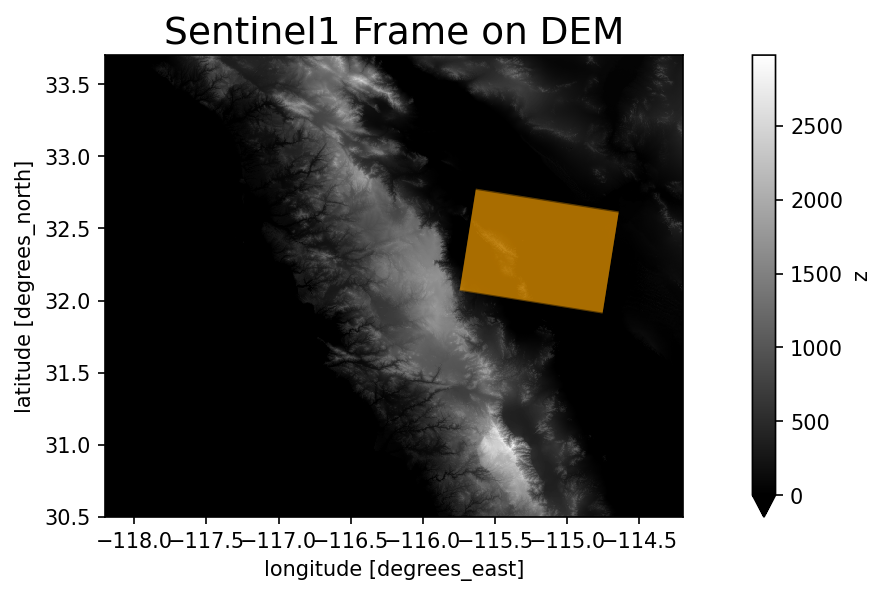

In [16]:
plt.figure(figsize=(12,4), dpi=150)
dem = sbas.get_dem()
dem[::4,::4].plot.imshow(cmap='gray', vmin=0)
sbas.to_dataframe().plot(color='orange', alpha=0.2, ax=plt.gca())
plt.title('Sentinel1 Frame on DEM', fontsize=18)
plt.show()

### Interactive Plot

Be careful because interactive plots require more RAM to be visualized

The plots below do not work on Debian 10 and Python 3.7

In [17]:
plots = None
if USE_INTERACTIVE_PLOTS:
    title = 'Subswath Topo'
    opts_common = {'x':'lon', 'y':'lat', 'geo':True, 'width':800, 'height':400}
    plots = sbas.get_dem()[::4,::4].hvplot(cmap='gray', alpha=1, title=title, **opts_common) \
        * sbas.to_dataframe().reset_index().hvplot(color='date', alpha=0.2, **opts_common)
plots

## Align a Stack of Images

In [18]:
sbas.stack_parallel()

Reference:   0%|          | 0/1 [00:00<?, ?it/s]

Aligning:   0%|          | 0/4 [00:00<?, ?it/s]

## SBAS Baseline

In [19]:
baseline_pairs = sbas.baseline_pairs(days=BASEDAYS, meters=BASEMETERS)
baseline_pairs

PRM generation:   0%|          | 0/5 [00:00<?, ?it/s]

,ref_date,rep_date,ref_timeline,ref_baseline,rep_timeline,rep_baseline
0,2015-01-21,2015-03-10,2015.05,52.61,2015.19,-37.72
1,2015-01-21,2015-04-03,2015.05,52.61,2015.25,-0.00
2,2015-01-21,2015-04-27,2015.05,52.61,2015.32,-30.42
3,2015-03-10,2015-04-03,2015.19,-37.72,2015.25,-0.00
4,2015-03-10,2015-04-27,2015.19,-37.72,2015.32,-30.42
5,2015-03-10,2015-05-21,2015.19,-37.72,2015.38,-50.97
6,2015-04-03,2015-04-27,2015.25,-0.00,2015.32,-30.42
7,2015-04-03,2015-05-21,2015.25,-0.00,2015.38,-50.97
8,2015-04-27,2015-05-21,2015.32,-30.42,2015.38,-50.97


### Static Plot

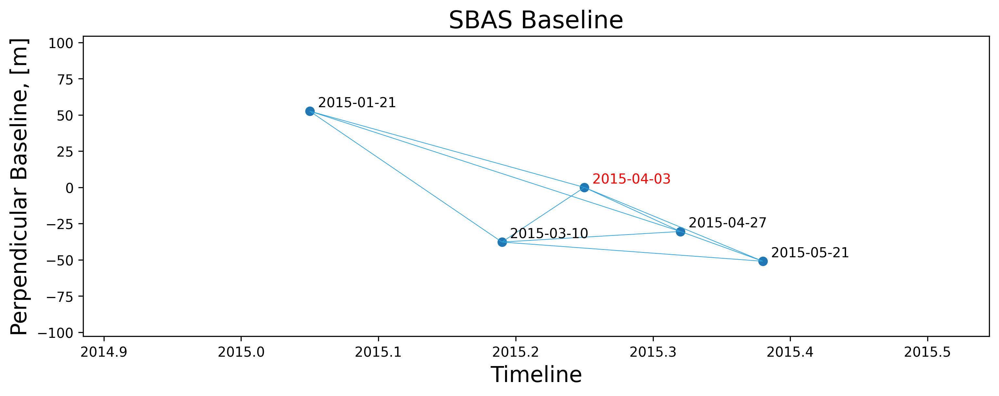

In [20]:
plt.figure(figsize=(12,4), dpi=300)
ax = plt.gca()

lines = [[(row.ref_timeline,row.ref_baseline),(row.rep_timeline,row.rep_baseline)]
         for row in baseline_pairs.itertuples()]
lc = matplotlib.collections.LineCollection(lines, colors='#30a2da', linewidths=0.5)
ax.add_collection(lc)
ax.autoscale()
ax.margins(0.5)
bs1 = baseline_pairs[['ref_timeline','ref_baseline','ref_date']].values
bs2 = baseline_pairs[['rep_timeline','rep_baseline','rep_date']].values
df = pd.DataFrame(np.concatenate([bs1, bs2]), columns=['timeline','baseline','date']).drop_duplicates()
plt.scatter(x=df.timeline, y=df.baseline)
for x,y,label in df.values:
    plt.annotate(label, (x,y), textcoords="offset points", xytext=(35,3), ha='center',
                 c='red' if label == MASTER else 'black')
ax.set_xlabel('Timeline', fontsize=16)
ax.set_ylabel('Perpendicular Baseline, [m]', fontsize=16)
ax.set_title('SBAS Baseline', fontsize=18)
plt.show()

## DEM in Radar Coordinates

In [21]:
sbas.topo_ra_parallel()

Radar Transform Computing sw1:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

INFO:distributed.scheduler:Receive client connection: Client-worker-9838d114-df78-11ed-9265-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:33010
INFO:distributed.scheduler:Receive client connection: Client-worker-99d82d0c-df78-11ed-9263-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:33024


Analyze Transform Blocks:   0%|          | 0/6 [00:00<?, ?it/s]

Radar Topography Computing sw1:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

### Load Grids

The grids are NetCDF files processing as xarray DataArrays.

In [22]:
topo_ra = sbas.get_topo_ra()

### Static Plot

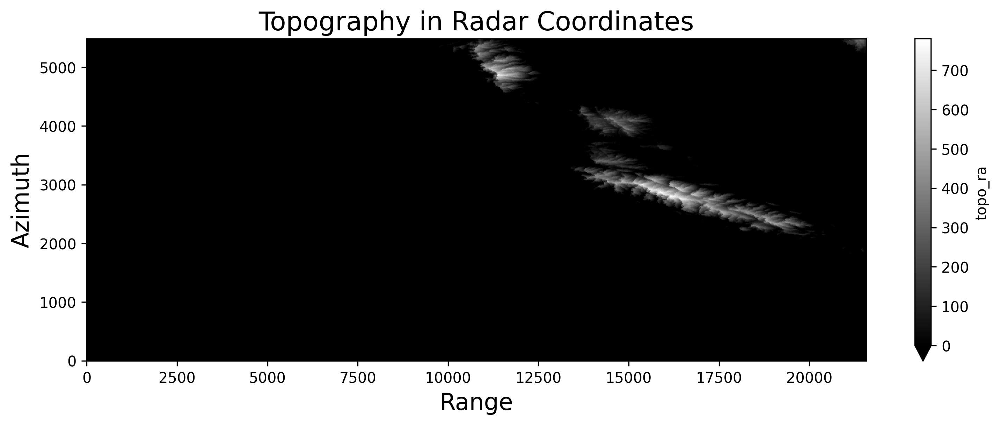

In [23]:
plt.figure(figsize=(12,4), dpi=300)
topo_ra[::4,::4].plot.imshow(cmap='gray', vmin=0)
plt.xlabel('Range', fontsize=16)
plt.ylabel('Azimuth', fontsize=16)
plt.title('Topography in Radar Coordinates', fontsize=18)
plt.show()

### Interactive Plot

Be careful because interactive plots require more RAM to be visualized

The plots below do not work on Debian 10 and Python 3.7

In [24]:
plots = None
if USE_INTERACTIVE_PLOTS:
    plot_opts = {'rasterize': True, 'xlabel':'Range', 'ylabel':'Azimuth', 'width':500, 'height':400}
    plots = topo_ra[::4,::4].hvplot(cmap='gray', title='Topography in Radar Coordinates', **plot_opts)
plots

## Interferograms

Define a single interferogram or a SBAS series. Make direct and reverse interferograms (from past to future or from future to past).

Decimation is useful to save disk space. Geocoding results are always produced on the provided DEM grid so the output grid and resolution are the same to the DEM. By this way, ascending and descending orbit results are always defined on the same grid by design. An internal processing cell is about 30 x 30 meters size and for default output 60m resolution (like to GMTSAR and GAMMA software) decimation 2x2 is reasonable. For the default wavelength=200 for Gaussian filter 1/4 of wavelength is approximately equal to ~60 meters and better resolution is mostly useless (while it can be used for small objects detection). For wavelength=400 meters use 90m DEM resolution with decimation 4x4.

The grids are NetCDF files processing as xarray DataArrays.

In [25]:
pairs = baseline_pairs[['ref_date', 'rep_date']]
pairs

,ref_date,rep_date
0,2015-01-21,2015-03-10
1,2015-01-21,2015-04-03
2,2015-01-21,2015-04-27
3,2015-03-10,2015-04-03
4,2015-03-10,2015-04-27
5,2015-03-10,2015-05-21
6,2015-04-03,2015-04-27
7,2015-04-03,2015-05-21
8,2015-04-27,2015-05-21


In [26]:
# SRTM3 DEM resolution 3 sec, 90 m but use 60 m instead to follow NetCDF chunks size 512x512
decimator = sbas.pixel_decimator(resolution_meters=60, debug=True)

# default parameters: wavelength=200, psize=32, func=None (no postprocessing)
sbas.intf_parallel(pairs, wavelength=400, func=decimator)

DEBUG: average per subswaths ground pixel size in meters: y=14.0, x=16.7
DEBUG: decimator = lambda da: da.coarsen({'y': 4, 'x': 4}, boundary='trim').mean()


Interferograms:   0%|          | 0/9 [00:00<?, ?it/s]

INFO:distributed.utils_perf:full garbage collection released 57.09 MiB from 6876 reference cycles (threshold: 9.54 MiB)


## Build Geocoding Matrices (Optional)

Source grid pixels can be translated to the target grid pixels very fast using the geocoding matrices.

In [27]:
sbas.geocode_parallel(pairs)

Radar Transform Computing sw1:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Analyze Transform Blocks:   0%|          | 0/6 [00:00<?, ?it/s]

Radar Topography Computing sw1:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Loading:   0%|          | 0/9 [00:00<?, ?it/s]

Analyze Transform Blocks:   0%|          | 0/6 [00:00<?, ?it/s]

Build ll2ra Transform:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Build ra2ll Transform:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

### Load Grids

The grids can be cropped automatically to drop empty areas around valid area (use crop_valid=True). On-the fly geocoding from radar to geographic coordinates is possible by geocode=True.

The grids are NetCDF files in radar coordinates processing as xarray DataArrays.

In [28]:
phasefilts = sbas.open_grids(pairs, 'phasefilt')
phasefilts_ll = sbas.open_grids(pairs, 'phasefilt', geocode=True)

Loading:   0%|          | 0/9 [00:00<?, ?it/s]

Loading:   0%|          | 0/9 [00:00<?, ?it/s]

### Static Plots

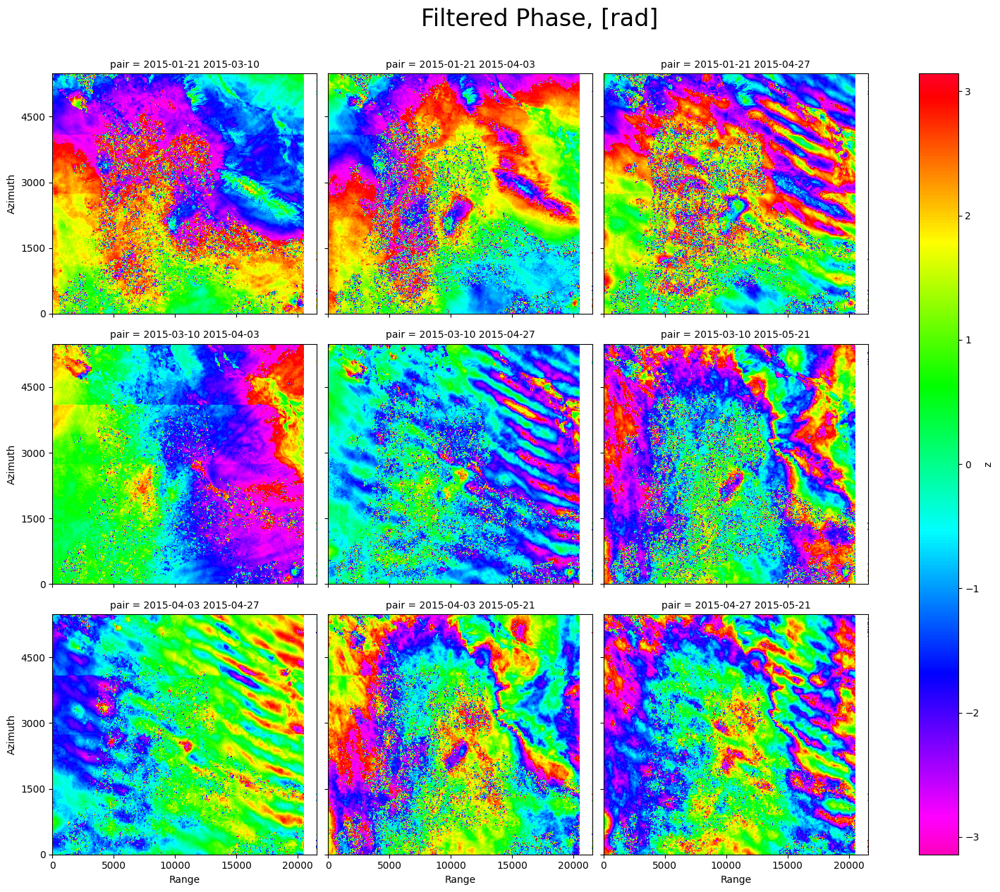

In [29]:
fg = phasefilts.plot.imshow(
    col="pair",
    col_wrap=3, size=4, aspect=1.2,
    vmin=-np.pi, vmax=np.pi, cmap='gist_rainbow_r'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Filtered Phase, [rad]', y=1.05, fontsize=24)
plt.show()

### Interactive Plot

Be careful because interactive plots require more RAM to be visualized

The plots below do not work on Debian 10 and Python 3.7

In [30]:
plots = None
if USE_INTERACTIVE_PLOTS:
    plots = phasefilts\
    .hvplot(by='pair', width=320, height=280, subplots=True,
            xlabel='Range', ylabel='Azimuth',
            clim=(-np.pi,np.pi), cmap='gist_rainbow_r')\
    .cols(3).opts(title='Filtered Phase, [rad]')
plots

### Load Grids

The grids can be cropped automatically to drop empty areas around valid area (use crop_valid=True). On-the fly geocoding from radar to geographic coordinates is possible by geocode=True.

The grids are NetCDF files in radar coordinates processing as xarray DataArrays.

In [31]:
corrs = sbas.open_grids(pairs, 'corr')

Loading:   0%|          | 0/9 [00:00<?, ?it/s]

### Static Plots

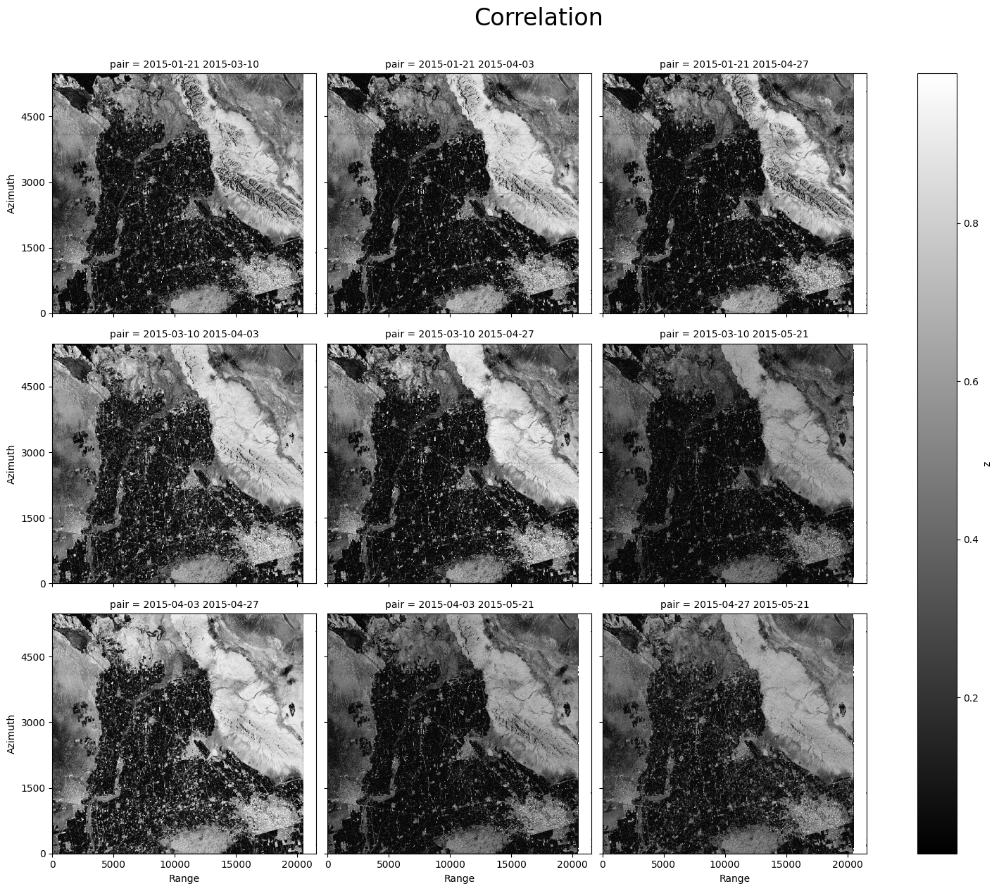

In [32]:
fg = corrs.plot.imshow(
    col="pair",
    col_wrap=3, size=4, aspect=1.2,
    clim=(0, 0.8), cmap='gray'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Correlation', y=1.05, fontsize=24)
plt.show()

### Interactive Plot

Be careful because interactive plots require more RAM to be visualized

The plots below do not work on Debian 10 and Python 3.7

In [33]:
plots = None
if USE_INTERACTIVE_PLOTS:
    plots = corrs\
    .hvplot(by='pair', width=320, height=280, subplots=True,
            xlabel='Range', ylabel='Azimuth',
            clim=(0, 0.8), cmap='gray')\
    .cols(3).opts(title='Correlation')
plots

## Unwrapping

Unwrapping process requires a lot of RAM and that's really RAM consuming when a lot of parallel proccesses running togeter. To limit the parallel processing tasks apply argument "n_jobs". The default value n_jobs=-1 means all the processor cores van be used. Also, use interferogram decimation above to produce smaller interferograms. And in addition a custom SNAPHU configuration can reduce RAM usage as explained below.

Attention: in case of crash on MacOS Apple Silicon run Jupyter as

`OBJC_DISABLE_INITIALIZE_FORK_SAFETY=YES no_proxy='*' jupyter notebook`

### Unwrapping Post-Processing

Define post-processing function to exclude low-coherence areas and maybe fill them by nearest neighbour interpolation.

### Use individual interferogram correlation values and interpolate gaps later for SBAS analysis

Select the correlation threshold to drop water surfaces and forested areas (usually forming a set of dense areas). Here valid pixels are different between interferograms because these are defined using individual correlation maps. To build valid pixel timeseries for SBAS analysis fill NODATA gaps using nearest interpolation.

In [34]:
CORRLIMIT = 0.075

# fill NODATA gaps for valid pixels only
interpolator = lambda corr, unwrap: sbas.nearest_grid(unwrap).where(corr>=0)

sbas.unwrap_parallel(pairs, threshold=CORRLIMIT, func=interpolator)

Unwrapping:   0%|          | 0/9 [00:00<?, ?it/s]

### Use average stack correlation to define persistent scatters to combine SBAS plus PSI analyses

Select the correlation threshold to define persistent scatterers (usually only sparse pixels). The spare persistent scatters defined equally for all the interferograms and these are ready for SBAS analysis.

In [35]:
#CORRLIMIT = 0.3

# build stack of correlation grids for all the interferometry pairs
#corr_stack = corrs.mean('pair')

# define a post-processing function to crop low-coherence areas
#filter = lambda corr, unwrap: xr.where(corr_stack>=CORRLIMIT, unwrap, np.nan)

#sbas.unwrap_parallel(pairs, func=filter)

### Load Grid

The grids can be cropped automatically to drop empty areas around valid area. Use `open_grids(..., crop_valid=True)` to enable the auto cropping feature. Argument geocode=True means on-the-fly geocoding from radar to geographic coordinates (all the grids saved on disk in radar coordinates plus geocoding matrices are generated for the fast geocoding).

In [36]:
unwraps = sbas.open_grids(pairs, 'unwrap')

Loading:   0%|          | 0/9 [00:00<?, ?it/s]

### Static Plots

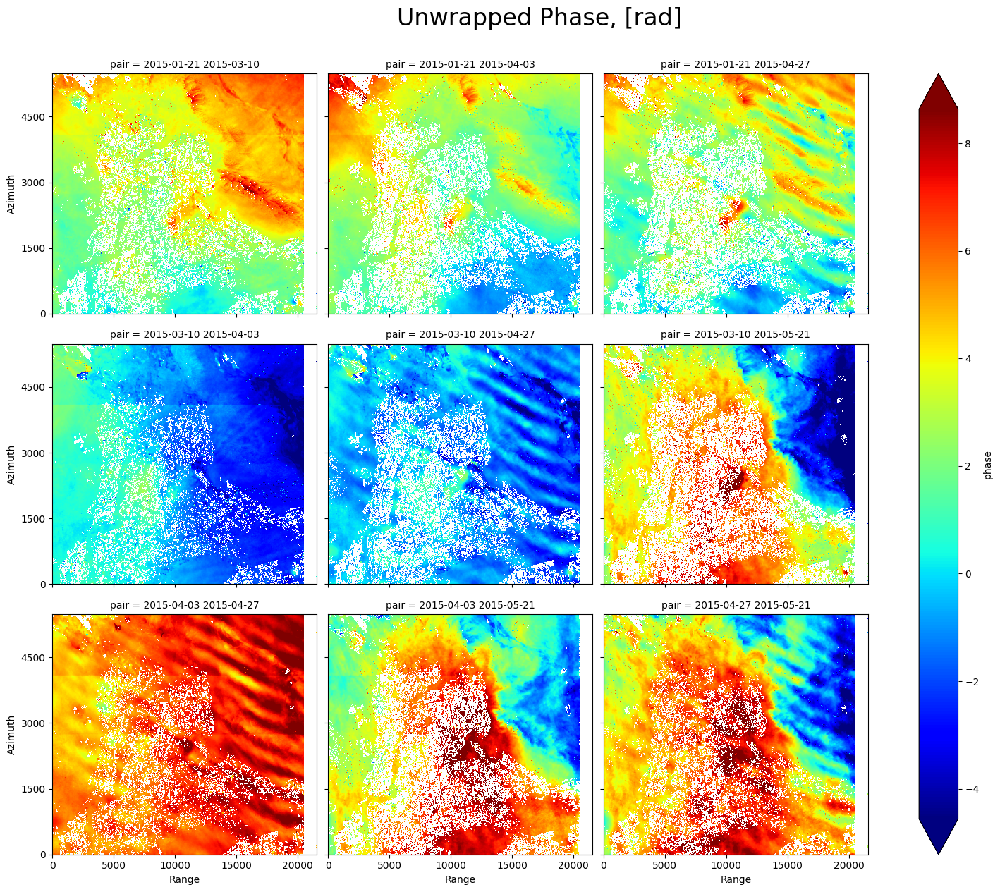

In [37]:
zmin, zmax = np.nanquantile(unwraps, [0.01, 0.99])
fg = unwraps.plot.imshow(
    col="pair",
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Unwrapped Phase, [rad]', y=1.05, fontsize=24)
plt.show()

### Interactive Plot

Be careful because interactive plots require more RAM to be visualized

The plots below do not work on Debian 10 and Python 3.7

In [38]:
plots = None
if USE_INTERACTIVE_PLOTS:
    plots = unwraps\
    .hvplot(by='pair', width=320, height=280, subplots=True, cmap='turbo',
            xlabel='Range', ylabel='Azimuth',
            clim=tuple(np.nanquantile(unwraps, [0.01, 0.99])))\
    .cols(3).opts(title='Unwrapped Phase, [rad]')
plots

## LOS Displacement

### Load and Calculate Grid

The grids can be post-processed using user-defined function "func". SBAS function `los_displacement_mm()` converts unwrapped phase values to LOS displacement in millimeters.

In [39]:
los_disp_mm = sbas.open_grids(pairs, 'unwrap', func=sbas.los_displacement_mm)

Loading:   0%|          | 0/9 [00:00<?, ?it/s]

### Static Plots

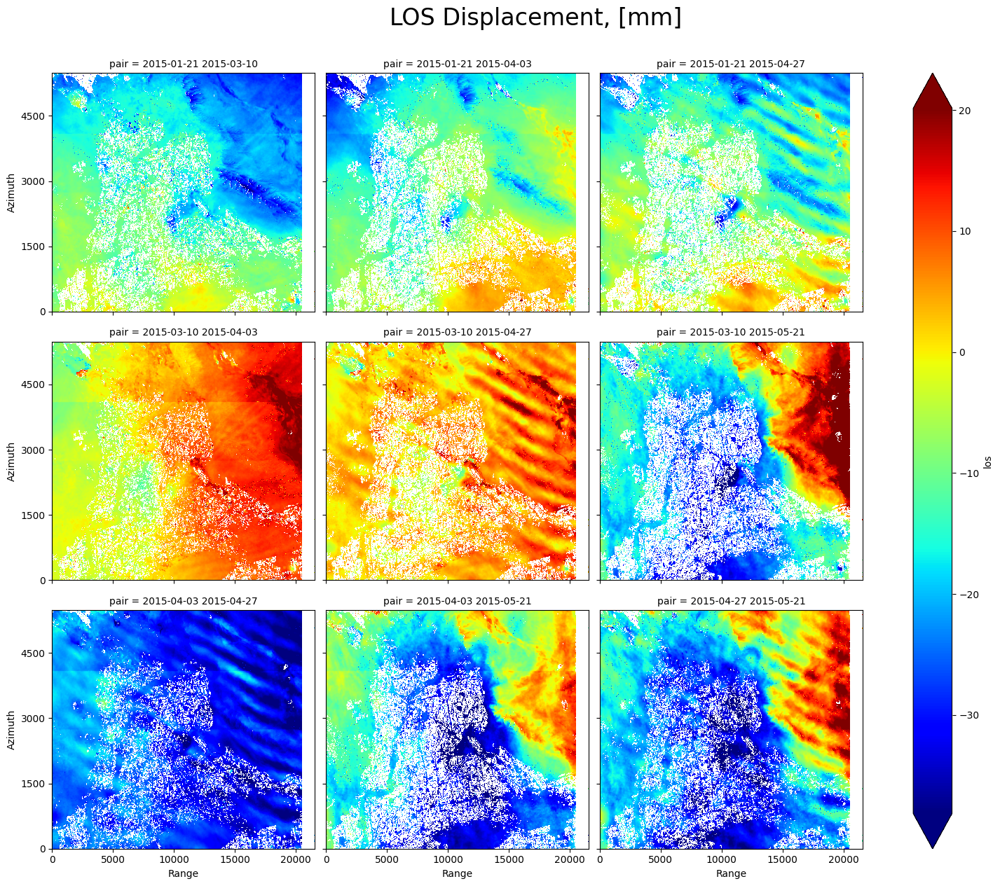

In [40]:
zmin, zmax = np.nanquantile(los_disp_mm, [0.01, 0.99])
fg = los_disp_mm.plot.imshow(
    col="pair",
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('LOS Displacement, [mm]', y=1.05, fontsize=24)
plt.show()

### Interactive Plot

Be careful because interactive plots require more RAM to be visualized

The plots below do not work on Debian 10 and Python 3.7

In [41]:
plots = None
if USE_INTERACTIVE_PLOTS:
    plots = los_disp_mm\
    .hvplot(by='pair', width=320, height=280, subplots=True, cmap='turbo',
            xlabel='Range', ylabel='Azimuth',
            clim=tuple(np.nanquantile(los_disp_mm, [0.01, 0.99])))\
    .cols(3).opts(title='LOS Displacement, [mm]')
plots

### Geocoding

PyGMTSAR provides a different approach to geocoding - it's a fast matrix operation on a radar-coordinates NetCDF grids stored on disk. By this way, geocoding is very easy and fast - just provide option geocode=True to open the grids.

In [42]:
los_disp_mm_ll = sbas.open_grids(pairs, 'unwrap', geocode=True, func=sbas.los_displacement_mm)

Loading:   0%|          | 0/9 [00:00<?, ?it/s]

### Static Plots

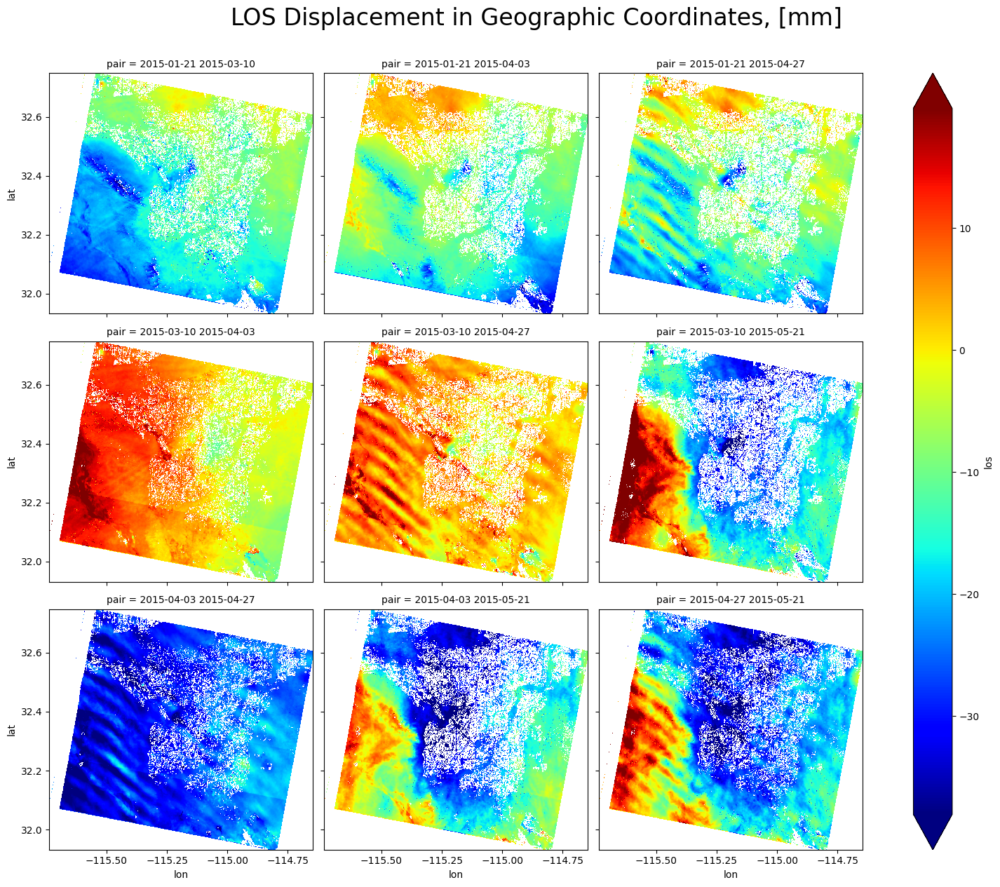

In [43]:
zmin, zmax = np.nanquantile(los_disp_mm_ll, [0.01, 0.99])
fg = los_disp_mm_ll.plot.imshow(
    col="pair",
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('LOS Displacement in Geographic Coordinates, [mm]', y=1.05, fontsize=24)
plt.show()

## GMTSAR SBAS Displacement and Velocity

In [44]:
baseline_pairs

,ref_date,rep_date,ref_timeline,ref_baseline,rep_timeline,rep_baseline
0,2015-01-21,2015-03-10,2015.05,52.61,2015.19,-37.72
1,2015-01-21,2015-04-03,2015.05,52.61,2015.25,-0.00
2,2015-01-21,2015-04-27,2015.05,52.61,2015.32,-30.42
3,2015-03-10,2015-04-03,2015.19,-37.72,2015.25,-0.00
4,2015-03-10,2015-04-27,2015.19,-37.72,2015.32,-30.42
5,2015-03-10,2015-05-21,2015.19,-37.72,2015.38,-50.97
6,2015-04-03,2015-04-27,2015.25,-0.00,2015.32,-30.42
7,2015-04-03,2015-05-21,2015.25,-0.00,2015.38,-50.97
8,2015-04-27,2015-05-21,2015.32,-30.42,2015.38,-50.97


In [45]:
sbas.sbas(baseline_pairs, smooth=1)

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

### Load Displacement Grids with Interpolation and Geocoding

As geocoding the interpolation is too just a option to open the radar-coordinates NetCDF grids.

In [46]:
disps = sbas.open_grids(sbas.df.index, 'disp', func=sbas.nearest_grid, mask=phasefilts.min('pair'), add_subswath=False)
disps_ll = sbas.open_grids(sbas.df.index, 'disp', geocode=True,
                           func=sbas.nearest_grid, mask=phasefilts_ll.min('pair'), add_subswath=False)

Loading:   0%|          | 0/5 [00:00<?, ?it/s]

Loading:   0%|          | 0/5 [00:00<?, ?it/s]

### Static Plots

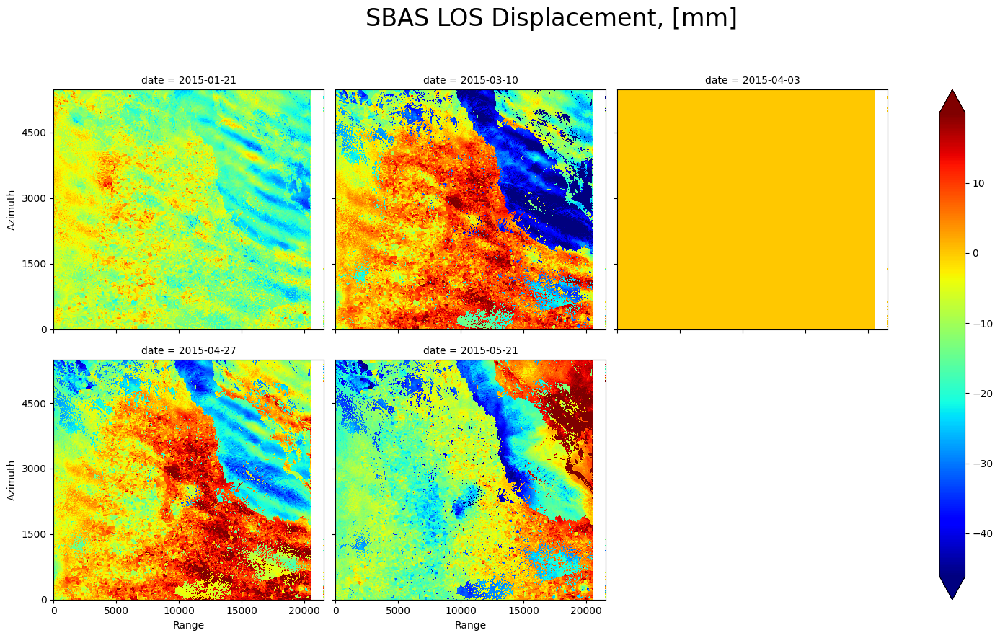

In [47]:
zmin, zmax = np.nanquantile(disps, [0.01, 0.99])
fg = disps.plot.imshow(
    col="date",
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('SBAS LOS Displacement, [mm]', y=1.1, fontsize=24)
plt.show()

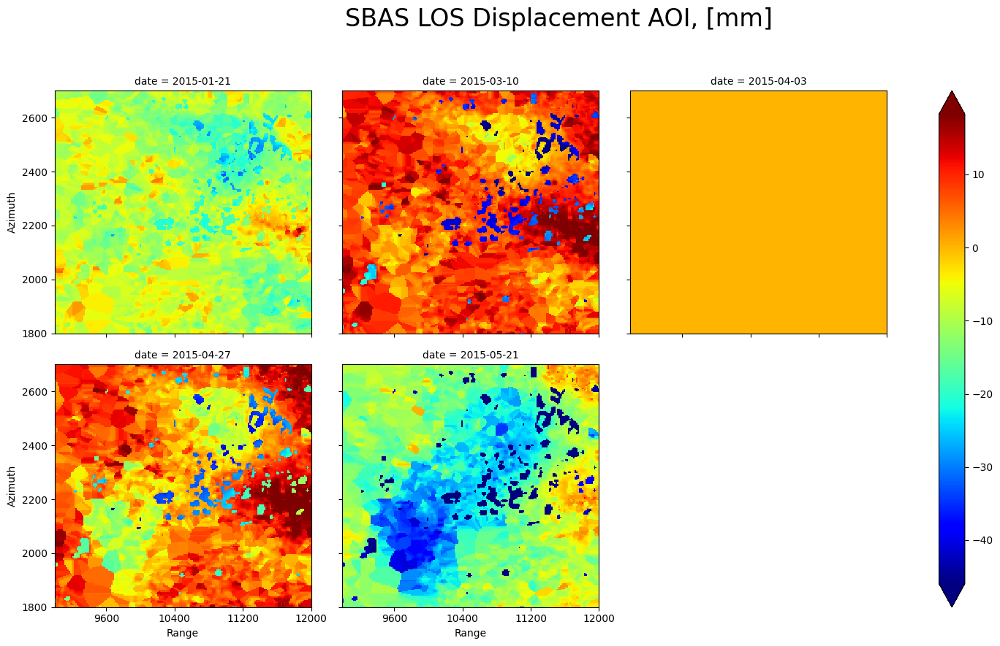

In [48]:
disps_subset = disps.sel(x=slice(9000,12000), y=slice(1800,2700))
zmin, zmax = np.nanquantile(disps_subset, [0.01, 0.99])
fg = disps_subset.plot.imshow(
    col="date",
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('SBAS LOS Displacement AOI, [mm]', y=1.1, fontsize=24)
plt.show()

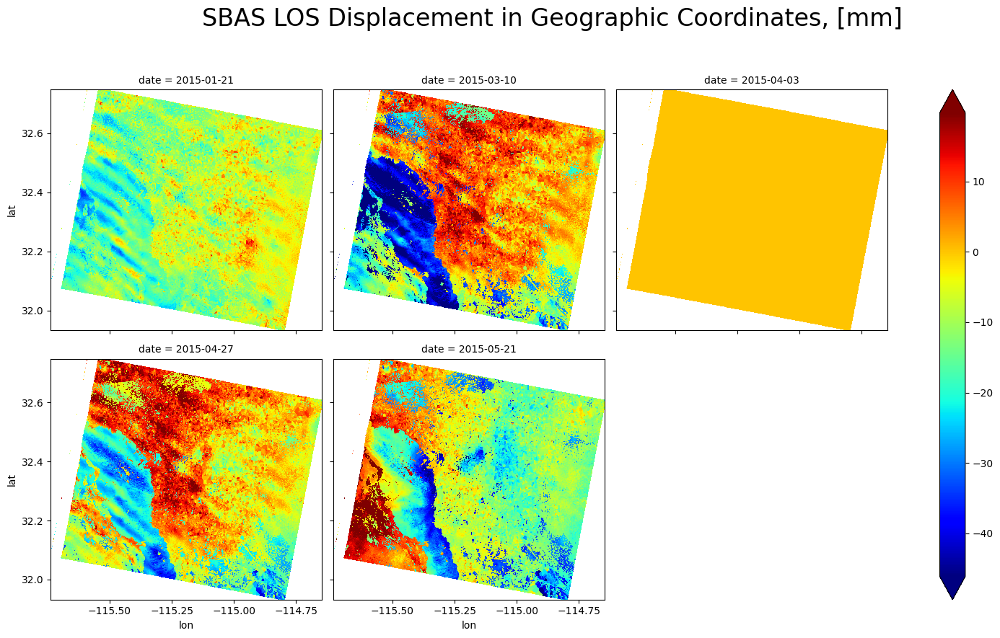

In [49]:
zmin, zmax = np.nanquantile(disps_ll, [0.01, 0.99])
fg = disps_ll.plot.imshow(
    col="date",
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('SBAS LOS Displacement in Geographic Coordinates, [mm]', y=1.1, fontsize=24)
plt.show()

### Load Velocity Grids with Interpolation and Geocoding

SBAS processing is based on GMTSAR function wich doesn't support PyGMTSAR files naming and so use option add_subswath=False to fix it.

In [50]:
vel = sbas.open_grids(None, 'vel', add_subswath=False)
vel_ll = sbas.open_grids(None, 'vel', geocode=True, add_subswath=False)
# interpolate low-coherency areas and mask not valid pixels
vel_filled = sbas.open_grids(None, 'vel', func=sbas.nearest_grid, mask=phasefilts.min('pair'), add_subswath=False)
vel_filled_ll = sbas.open_grids(None, 'vel', geocode=True,
                               func=sbas.nearest_grid, mask=phasefilts_ll.min('pair'), add_subswath=False)

### Static Plots

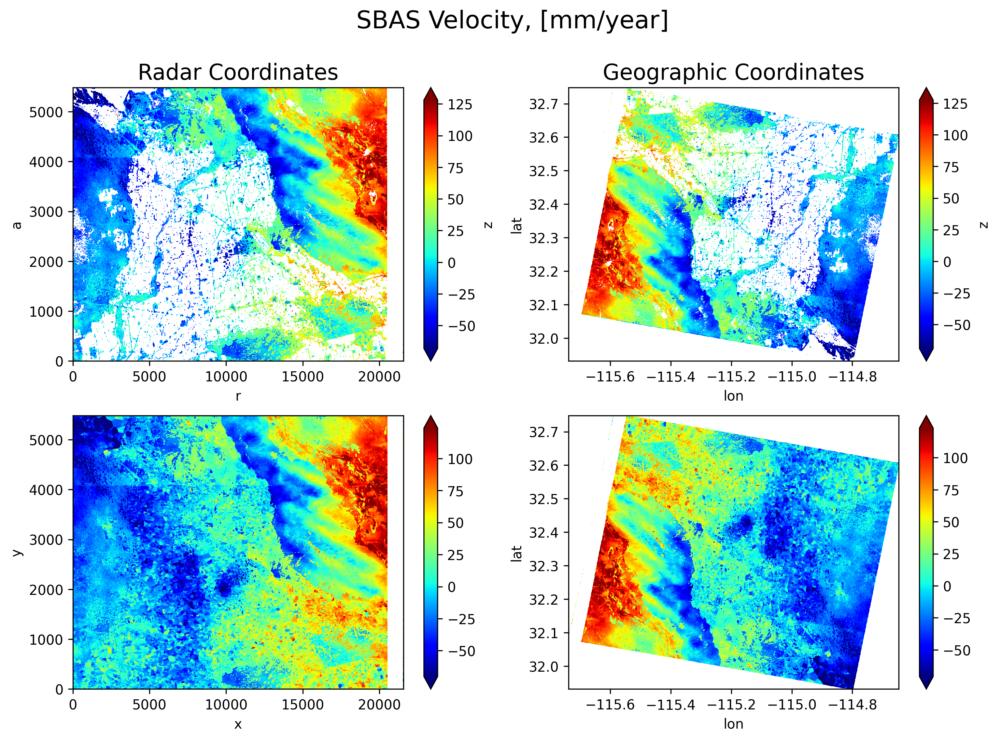

In [51]:
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(12, 8), dpi=300)
zmin, zmax = np.nanquantile(vel, [0.01, 0.995])
vel.plot(vmin=zmin, vmax=zmax, cmap='jet', ax=ax1)
zmin, zmax = np.nanquantile(vel_ll, [0.01, 0.995])
vel_ll.plot(vmin=zmin, vmax=zmax, cmap='jet', ax=ax2)
zmin, zmax = np.nanquantile(vel_filled, [0.01, 0.995])
vel_filled.plot(vmin=zmin, vmax=zmax, cmap='jet', ax=ax3)
zmin, zmax = np.nanquantile(vel_filled_ll, [0.01, 0.995])
vel_filled_ll.plot(vmin=zmin, vmax=zmax, cmap='jet', ax=ax4)
ax1.set_title('Radar Coordinates', fontsize=16)
ax2.set_title('Geographic Coordinates', fontsize=16)
plt.suptitle('SBAS Velocity, [mm/year]', fontsize=18)
plt.show()

### Interactive Plot

Be careful because interactive plots require more RAM to be visualized

The plots below do not work on Debian 10 and Python 3.7

In [52]:
plots = None
if USE_INTERACTIVE_PLOTS:
    zmin, zmax = np.nanquantile(vel_filled_ll, [0, 0.99])
    opts_common = {'x':'lon', 'y':'lat', 'geo':True, 'width':330, 'height':280,
                   'cmap':'turbo', 'colorbar':True, 'clim':(zmin, zmax)}
    opts1 = {'tiles':gstiles, 'alpha':0.4, 'title':'Google Satellite'}
    opts2 = {'tiles':ottiles, 'alpha':0.4, 'title':'OpenTopoMap'}
    opts3 = {'tiles':False,   'alpha':1.4, 'title':'SBAS Velocity'}
    plots = vel_filled_ll.hvplot(**{**opts_common, **opts1}).opts(xrotation=45) + \
    vel_filled_ll.hvplot(**{**opts_common, **opts2}).opts(xrotation=45) + \
    vel_filled_ll.hvplot(**{**opts_common, **opts3}).opts(xrotation=45)
plots

## PyGMTSAR SBAS Displacement

### Detrend Unwrapped Phase

Remove trend and apply gaussian filter to fix ionospheric effects and solid Earh's tides. Fill empty areas using nearest interpolation.

In [53]:
sbas.detrend_parallel(pairs, wavelength=12000)

Detrending and Saving:   0%|          | 0/9 [00:00<?, ?it/s]

### Load Detrended Unwrapped Phase Grids

In [54]:
unwraps_detrend = sbas.open_grids(pairs, 'detrend')

Loading:   0%|          | 0/9 [00:00<?, ?it/s]

### Static Plots

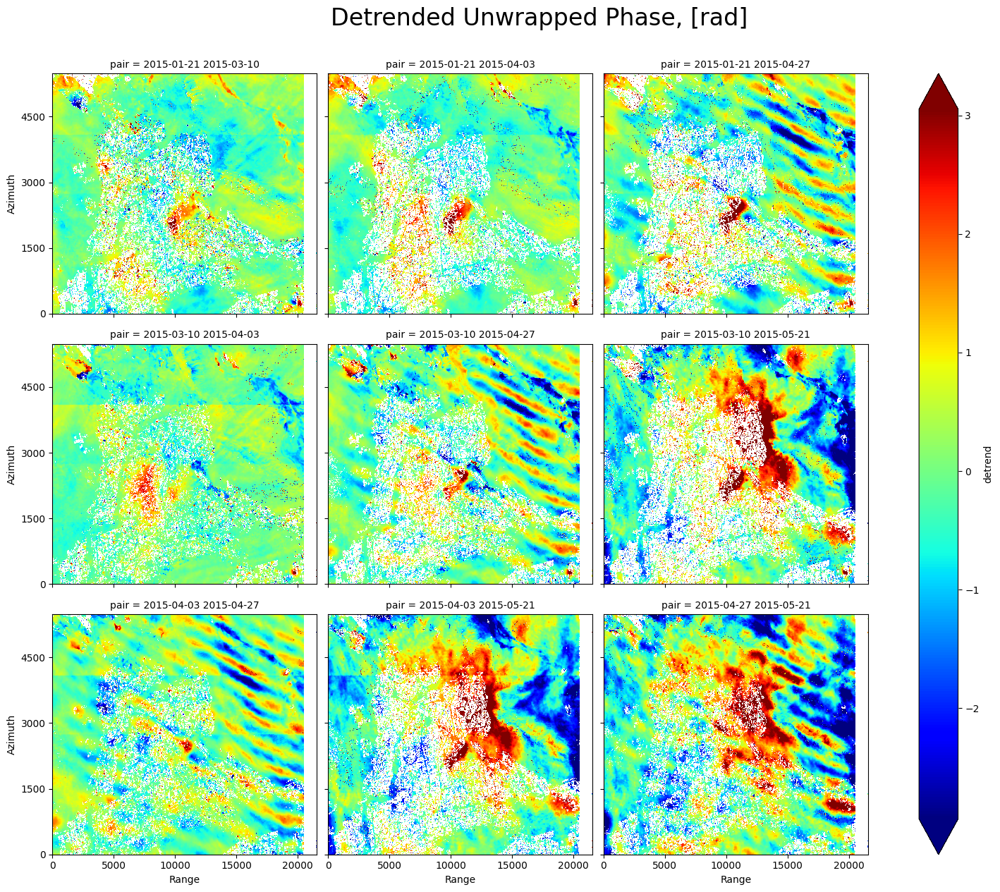

In [55]:
zmin, zmax = np.nanquantile(unwraps_detrend, [0.01, 0.99])
fg = unwraps_detrend.plot.imshow(
    col="pair",
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Detrended Unwrapped Phase, [rad]', y=1.05, fontsize=24)
plt.show()

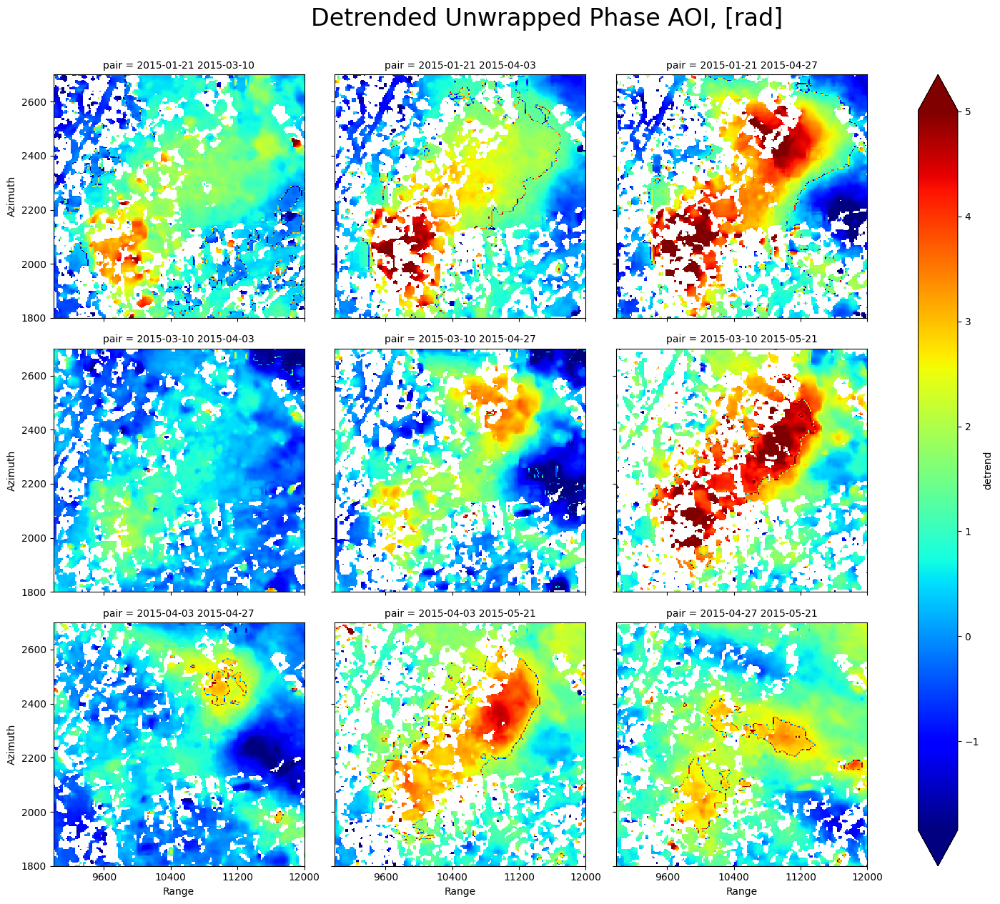

In [56]:
unwraps_detrend_subset = unwraps_detrend.sel(x=slice(9000,12000), y=slice(1800,2700))

zmin, zmax = np.nanquantile(unwraps_detrend_subset, [0.01, 0.99])
fg = unwraps_detrend_subset.plot.imshow(
    col="pair",
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Detrended Unwrapped Phase AOI, [rad]', y=1.05, fontsize=24)
plt.show()

### Calculate Displacement Using Coherence-Weighted Least-Squares Solution

In [57]:
# process the full unwrap grid (correlation grid will be cropped if needed)
sbas.sbas_parallel(pairs)

Computing:   0%|          | 0/9 [00:00<?, ?it/s]

Saving:   0%|          | 0/5 [00:00<?, ?it/s]

In [58]:
# use sorted dates to open all the grids
dates = np.unique(pairs.values.flatten() if isinstance(pairs, pd.DataFrame) else pairs.flatten())

### Load SBAS Results and Calculate LOS Displacement

In [59]:
# interpolate for valid coherence area only
valid_area = corrs.min('pair')
def interp(da):
    return sbas.nearest_grid(da).where(~np.isnan(valid_area))

# use wrapper "interp"  instead of "sbas.nearest_grid" for post-processing functions list below
disps = sbas.open_grids(dates, 'disp', func=[sbas.los_displacement_mm, interp])

Loading:   0%|          | 0/5 [00:00<?, ?it/s]

In [60]:
# prepare the results for better visualization
# filter outliers
#disps = disps.where(abs(disps)<1e3)
# clean 1st zero-filled displacement map for better visualization
disps[0] = np.nan
# calculate cumulative displacement like to GMTSAR SBAS
disps_cum = disps.cumsum('date')
# clean 1st zero-filled displacement map for better visualization
disps_cum[0] = np.nan

### Static Plots

INFO:distributed.utils_perf:full garbage collection released 77.63 MiB from 31458 reference cycles (threshold: 9.54 MiB)


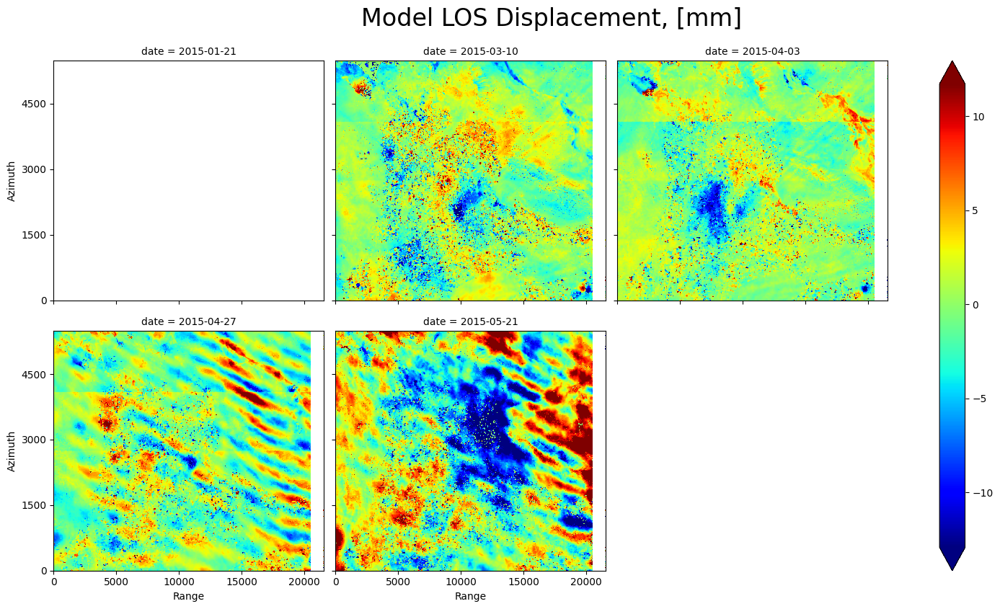

In [61]:
zmin, zmax = np.nanquantile(disps, [0.01, 0.99])
fg = disps.plot.imshow(
    col="date",
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Model LOS Displacement, [mm]', y=1.05, fontsize=24)
plt.show()

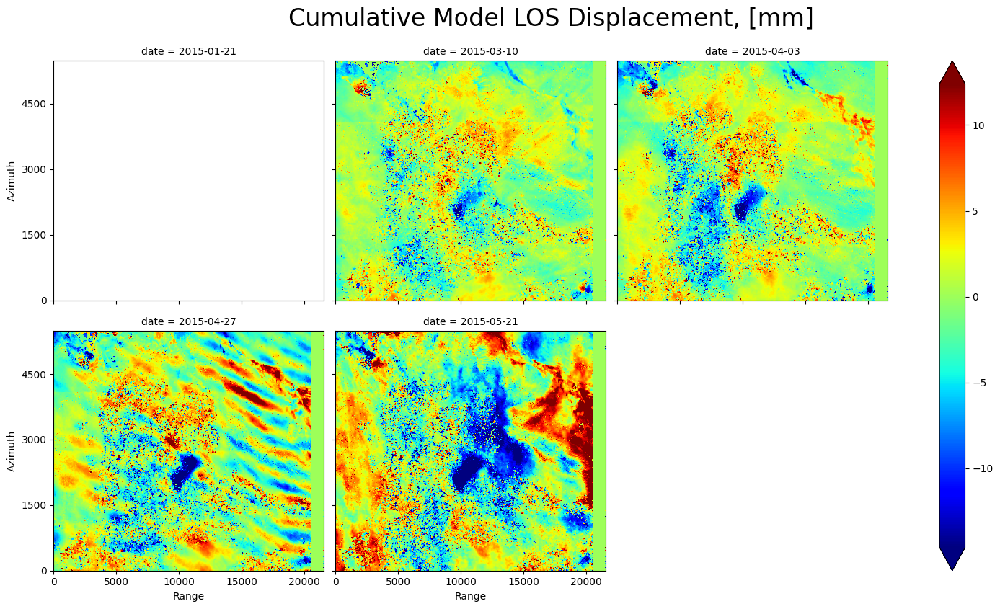

In [62]:
zmin, zmax = np.nanquantile(disps_cum, [0.01, 0.99])
fg = disps_cum.plot.imshow(
    col="date",
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Cumulative Model LOS Displacement, [mm]', y=1.05, fontsize=24)
plt.show()

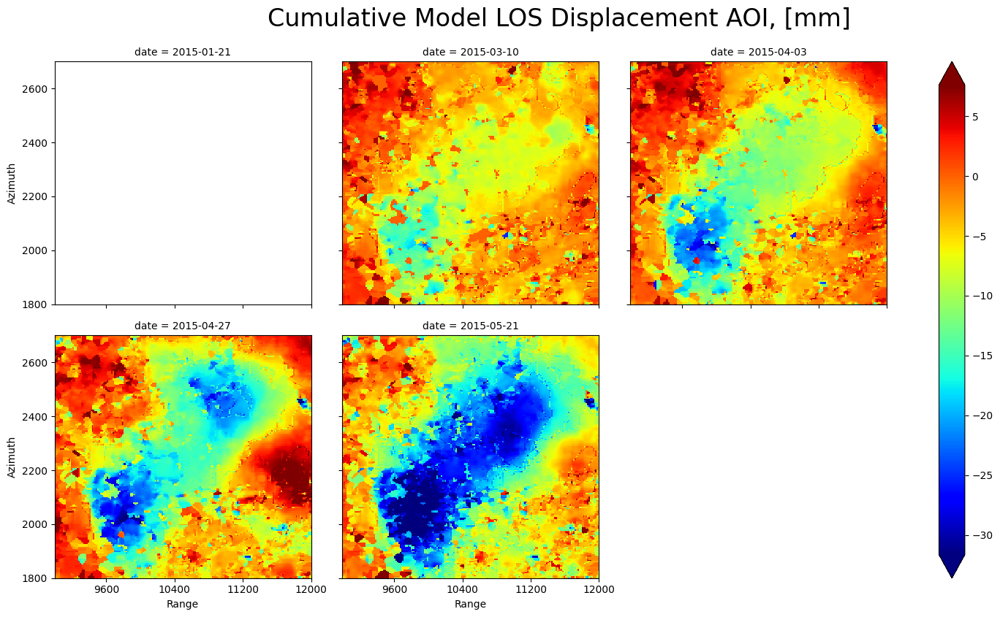

In [63]:
disps_cum_subset = disps_cum.sel(x=slice(9000,12000), y=slice(1800,2700))

zmin, zmax = np.nanquantile(disps_cum_subset, [0.01, 0.99])
fg = disps_cum_subset.plot.imshow(
    col='date',
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Cumulative Model LOS Displacement AOI, [mm]', y=1.05, fontsize=24)
plt.show()

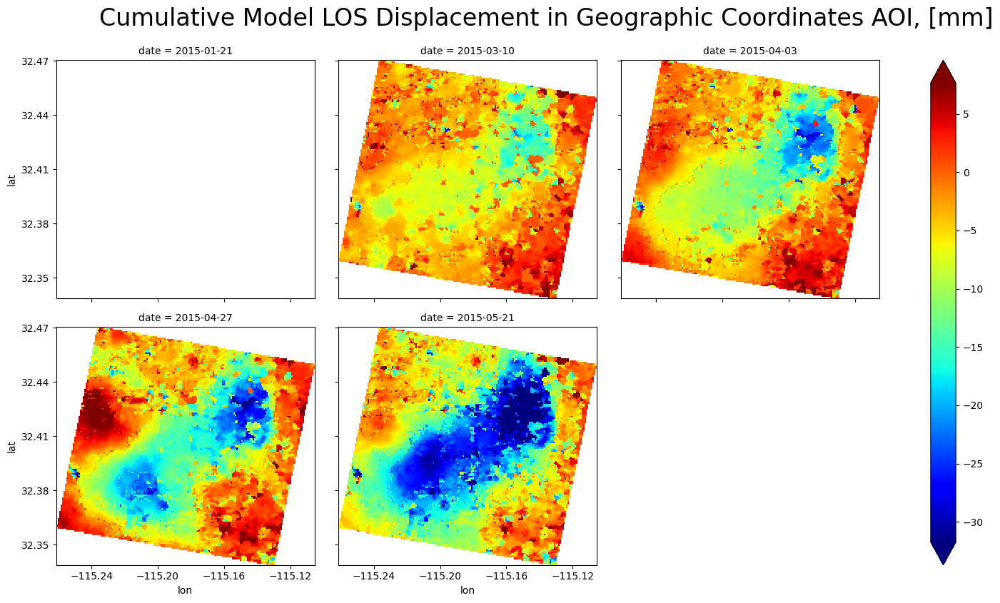

In [64]:
# geocode the subsets on the full interferogram grid and crop a valid area only
disps_cum_subset_ll = sbas.cropna(sbas.intf_ra2ll(disps_cum.sel(x=slice(9000,12000), y=slice(1800,2700))))

zmin, zmax = np.nanquantile(disps_cum_subset_ll, [0.01, 0.99])
fg = disps_cum_subset_ll.plot.imshow(
    col='date',
    col_wrap=3, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='jet'
)
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Cumulative Model LOS Displacement in Geographic Coordinates AOI, [mm]', y=1.05, fontsize=24)
plt.show()

## Conclusion

For now you have the full control on interferometry processing and unwrapping and able to run it everywhere: on free of charge Google Colab instances, on local MacOS and Linux computers and on Amazon EC2 and Google Cloud VM and AI Notebook instances.
    
The original GMTSAR example processing is enhanced by additional post-processing and SBAS result is better now.